utilize a versão 3.11.7 do python caso queira rodar os códigos e não se esqueça de instalar as bibbliotecas utilizadas

# Projeto de Análise de Descargas Atmosféricas

## Introdução ao Projeto
Este projeto tem como objetivo analisar dados de descargas atmosféricas, também conhecidas como raios. As descargas atmosféricas são fenômenos naturais poderosos e fascinantes que ocorrem em todo o mundo. Elas têm um impacto significativo no clima, na atmosfera e, em alguns casos, podem causar danos a infraestruturas e ser perigosas para os seres humanos.

## Dados
Os dados usados neste projeto incluem a data e hora de cada descarga atmosférica, a localização (latitude e longitude) da descarga e o tipo de descarga. O tipo de descarga pode ser uma descarga nuvem-solo (representada pelo valor 0) ou uma descarga intranuvem (representada pelo valor 1).

## Objetivos
O objetivo deste projeto é explorar esses dados para obter insights sobre as descargas atmosféricas. Algumas das perguntas que esperamos responder incluem:

- Onde ocorrem mais descargas atmosféricas?
- Como a frequência de descargas atmosféricas muda ao longo do tempo?
- Existe uma diferença na localização das descargas nuvem-solo e intranuvem?

# Descargas Atmosféricas: Nuvem-Solo e Intra-Nuvem

## Introdução

As descargas atmosféricas são fenômenos naturais poderosos que ocorrem na atmosfera da Terra. Existem dois tipos principais de descargas atmosféricas:

1. **Descargas Nuvem-Solo (CG - Cloud-to-Ground)**: Descargas que ocorrem entre uma nuvem e o solo.
2. **Descargas Intra-Nuvem (IC - Intra-Cloud)**: Descargas que acontecem dentro da nuvem.

Neste notebook, exploraremos esses dois tipos de descargas atmosféricas, suas características e algumas considerações importantes.

## Descargas Nuvem-Solo (CG)

As descargas nuvem-solo são eventos onde a eletricidade estática é liberada entre uma nuvem de tempestade e o solo. Estas podem ser subdivididas em:

- **Descargas Positivas**: Quando uma corrente elétrica flui do topo da nuvem para o solo.
- **Descargas Negativas**: Ocorrem quando uma corrente elétrica flui do solo para o topo da nuvem.

As descargas nuvem-solo são perigosas e podem causar danos sérios a estruturas, árvores e seres vivos, razão pela qual são objeto de estudo em meteorologia e segurança.

## Descargas Intra-Nuvem (IC)

As descargas intra-nuvem acontecem dentro de uma única nuvem de tempestade. Este fenômeno é responsável por grande parte da eletricidade em uma tempestade, onde diferentes regiões da mesma nuvem possuem cargas elétricas opostas.

- **Ramificações Horizontais**: Ocorrem entre diferentes partes da nuvem.
- **Ramificações Verticais**: A eletricidade é liberada verticalmente dentro da nuvem.

Estudar as descargas intra-nuvem é crucial para entender a dinâmica das tempestades e melhorar as previsões meteorológicas.

## Configuração do Ambiente

In [136]:
import folium
import numpy as np
import pandas as pd
import seaborn as sns
import plotly.express as px
import matplotlib.pyplot as plt
from folium.plugins import HeatMap, HeatMapWithTime

In [137]:
# Importando dados
df = pd.read_csv('../dados/dataset_2022.csv')
df.head(10)

,data,latitude,longitude,tipo
0,2022-01-01 16:55:56-03:00,-20.326783,-45.989391,0
1,2022-01-01 16:55:56-03:00,-20.322183,-45.987291,0
2,2022-01-01 16:55:56.985000-03:00,-20.337263,-45.975291,1
3,2022-01-01 16:55:56.997000-03:00,-20.334103,-45.985891,0
4,2022-01-01 16:55:57-03:00,-20.333383,-46.018591,0
5,2022-01-01 16:55:57.840000-03:00,-20.322533,-45.997191,0
6,2022-01-01 17:02:05.661000-03:00,-20.371793,-45.965791,0
7,2022-01-01 17:02:05.775160-03:00,-20.387983,-46.010191,0
8,2022-01-01 17:04:46.121540-03:00,-20.354183,-46.047491,1
9,2022-01-01 17:21:58-03:00,-20.331583,-46.216191,0


In [138]:
# EDA
print(df.describe())

            latitude      longitude           tipo
count  220701.000000  220701.000000  220701.000000
mean      -20.036394     -45.992885       0.664881
std         0.213697       0.233236       1.014207
min       -20.468373     -46.430891       0.000000
25%       -20.206683     -46.196691       0.000000
50%       -20.039283     -45.997491       1.000000
75%       -19.871303     -45.800191       1.000000
max       -19.569583     -45.526391      40.000000


In [139]:
# Informações sobre os dados
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 220701 entries, 0 to 220700
Data columns (total 4 columns):
 #   Column     Non-Null Count   Dtype  
---  ------     --------------   -----  
 0   data       220701 non-null  object 
 1   latitude   220701 non-null  float64
 2   longitude  220701 non-null  float64
 3   tipo       220701 non-null  int64  
dtypes: float64(2), int64(1), object(1)
memory usage: 6.7+ MB


## Tratando Dados

### Objetivos da Etapa

- Remover o valor erroneo de numero 40 da coluna tipo (A coluna tipo é uma coluna categórica com valores 1 e 0)

- Remover valor dos milissegundos (não vejo motivos para mantes estes valores na análise)

In [140]:
# Limpando os milisegundos dos dados
df['data'] = df['data'].str.slice(0, 19)
df['data'] = pd.to_datetime(df['data'])
df

,data,latitude,longitude,tipo
0,2022-01-01 16:55:56,-20.326783,-45.989391,0
1,2022-01-01 16:55:56,-20.322183,-45.987291,0
2,2022-01-01 16:55:56,-20.337263,-45.975291,1
3,2022-01-01 16:55:56,-20.334103,-45.985891,0
4,2022-01-01 16:55:57,-20.333383,-46.018591,0
...,...,...,...,...
220696,2022-12-31 21:14:53,-19.867303,-45.706591,1
220697,2022-12-31 21:14:53,-19.898383,-45.744691,1
220698,2022-12-31 21:17:14,-19.898783,-45.743891,1
220699,2022-12-31 21:19:20,-19.850383,-45.746191,1


In [141]:
# Removendo valor erroneo de 40
df.loc[df['tipo'] == 40, 'tipo'] = 1

## Feature Engineering

Objetivos de uma Feature Engineering é aumentar a qualidade e informações de um banco de dados com base nas informações existentes

### Objetivo da Etapa

Separar as horas da coluna data para uma futura análise, o objetivo desta separação é futuramente descobrir em qual horário ocorrem mais descargas.

In [142]:
# Criando uma nova coluna chamada hora
df.set_index('data', inplace=True)
df['hora'] = df.index.hour

## Análise do Conjunto de Dados Completo

vale resaltar que ao fim da análise juntarei todas as informações em uma análise mais aprofundada

Portanto, se for do interesse do leitor apenas as análises e conclusões e não os códigos aconselho pular para a ultima parte chamada insigths

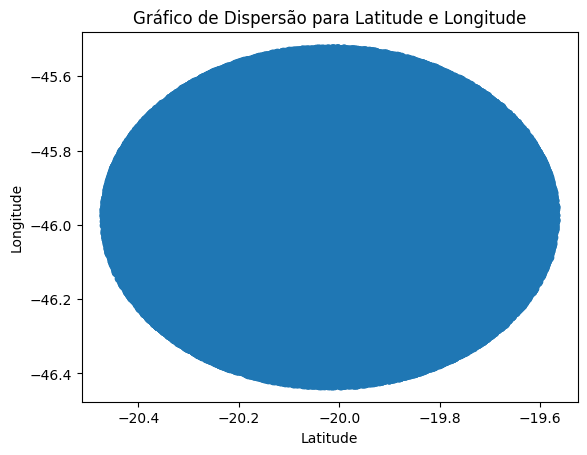

In [143]:
# O grafico de dispersão é usado para analisar a distribuição dos dados com base em outros, Pode ser usado para procurar a correlação entre ambos
# Porem neste caso quero analisar o formato da área de captura das descargas
plt.scatter(df['latitude'], df['longitude'])
plt.xlabel('Latitude')
plt.ylabel('Longitude')
plt.title('Gráfico de Dispersão para Latitude e Longitude')
plt.show()

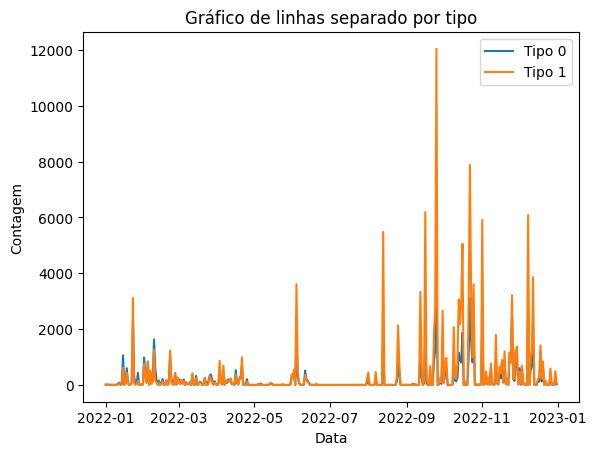

In [144]:
# Grafico de Linha, Gráficos de Linha são usados principalmente para analisar uma valor com base no passar do tempo
for tipo in df['tipo'].unique():
    df_tipo = df[df['tipo'] == tipo]
    df_tipo_resampled = df_tipo.resample('D').size()  # Resample para contagem diária
    plt.plot(df_tipo_resampled.index, df_tipo_resampled.values, label=f'Tipo {tipo}')
plt.xlabel('Data')
plt.ylabel('Contagem')
plt.title('Gráfico de linhas separado por tipo')
plt.legend()
plt.show()

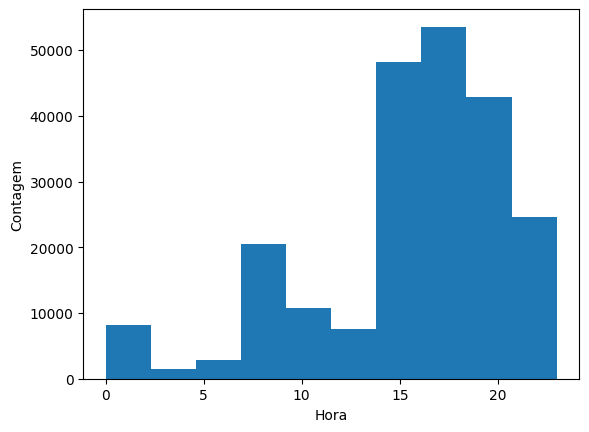

In [145]:
# Gráfico de Histograma, geralmente usado para analisar se os dados esão bem distribuidos
# Aqui utilizarei para identificar qual horário tem maior índice de descargas atmosféricas
df['hora'].plot(kind='hist')
plt.xlabel('Hora')
plt.ylabel('Contagem');

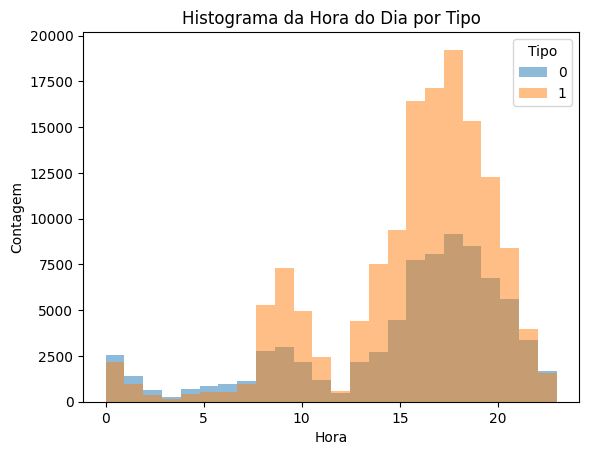

In [146]:
# Após analisar os horarios e identificar que apartir das 15 horas é esperado um grande aumento em relação a descaragas atmosféricas,
# Crio o gráfico abaixo para diferenciarmos as quantidads de descargas de cada tipo e compara-las lado a lado.
tipos = df['tipo'].unique()
for tipo in tipos:
    df_tipo = df[df['tipo'] == tipo]
    plt.hist(df_tipo['hora'], bins=24, alpha=0.5, label=str(tipo))
plt.legend(title='Tipo')
plt.xlabel('Hora')
plt.ylabel('Contagem')
plt.title('Histograma da Hora do Dia por Tipo')
plt.show()

In [147]:
# Resetando o index, desta forma será possível separar a coluna data para a análise diária
df.reset_index(inplace=True)

In [148]:
# Agora, a análise com base na localização e contagem de descargas é impressindivel
# Vamos criar um gráfico de densidade, assim será possivel descobrir qual área tem maior índice de raios
latitude_central = df['latitude'].median()
longitude_central = df['longitude'].median()
m = folium.Map(location=[latitude_central, longitude_central], zoom_start=9)
data = df[['latitude', 'longitude']].values.tolist()
HeatMap(data, blur=30, max_opacity=0.2).add_to(m)

m

In [150]:
# O histograma abaixo serve para que possamos vizualizar os horários dos dias separadamente

# Separar o dia da coluna data
df['dia'] = df['data'].dt.date

fig = px.histogram(df, x="hora", color="tipo", animation_frame="dia", nbins=24)
fig.show()

In [ ]:
# O mapa abaixo é uma versão animada do primeiro gráfico, ele tambem foi criado com o objetivo de analisar separadamente os dias e suas descargas geográficas
data = []
for dia, group in df.groupby('dia'):
    day_data = [[row['latitude'], row['longitude']] for idx, row in group.iterrows()]
    data.append(day_data)
index = [str(dia) for dia in df['dia'].unique()]
m = folium.Map(location=[df['latitude'].median(), df['longitude'].median()], zoom_start=9)
HeatMapWithTime(data, index=index).add_to(m)

m

## Análise Separadamente

Vamos tentar entender se há diferenças no comportamento das descargas com base nos tipos

In [ ]:
# Criando um dataframe para cada tipo de descarga atmosférica
df_tipo_0 = df[df['tipo'] == 0]
df_tipo_1 = df[df['tipo'] == 1]

### Tipo 0 (Intranuvem)

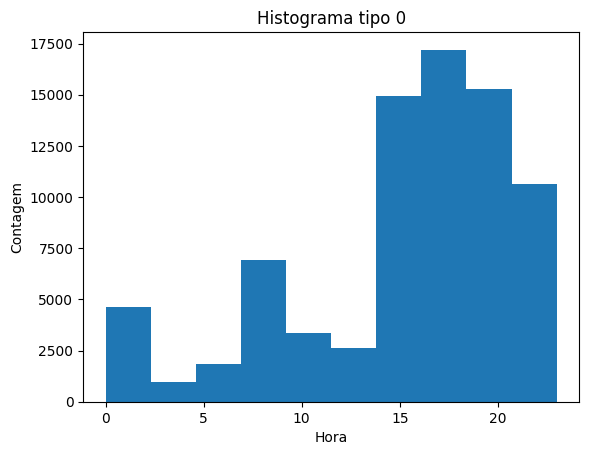

In [ ]:
# Tipo 0
df_tipo_0['hora'].plot(kind='hist')
plt.xlabel('Hora')
plt.ylabel('Contagem');
plt.title('Histograma tipo 0');

In [ ]:
# Análise das incidencias por tipo
latitude_central = df_tipo_0['latitude'].median()
longitude_central = df_tipo_0['longitude'].median()
m = folium.Map(location=[latitude_central, longitude_central], zoom_start=9)
data = df_tipo_0[['latitude', 'longitude']].values.tolist()
HeatMap(data, blur=30, max_opacity=0.2).add_to(m)

m

In [151]:
data = []
for dia, group in df_tipo_0.groupby('dia'):
    day_data = [[row['latitude'], row['longitude']] for idx, row in group.iterrows()]
    data.append(day_data)
index = [str(dia) for dia in df_tipo_0['dia'].unique()]
m = folium.Map(location=[df_tipo_0['latitude'].median(), df_tipo_0['longitude'].median()], zoom_start=9)
HeatMapWithTime(data, index=index).add_to(m)

m

### Tipo 1 (Nuvem-Solo)

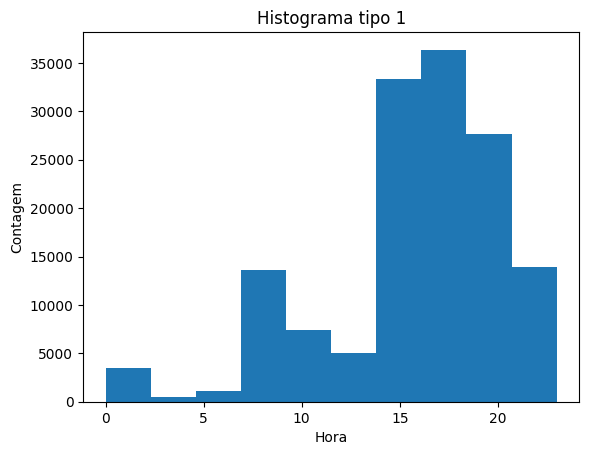

In [ ]:
# Analisando as distribuições das descargas do tipo 1
df_tipo_1['hora'].plot(kind='hist')
plt.xlabel('Hora')
plt.ylabel('Contagem')
plt.title('Histograma tipo 1');

In [ ]:
# mapa centrado em uma localização específica
latitude_central = df_tipo_1['latitude'].median()
longitude_central = df_tipo_1['longitude'].median()
m = folium.Map(location=[latitude_central, longitude_central], zoom_start=9)

# Crie uma lista de dados para o mapa de calor
data = df_tipo_1[['latitude', 'longitude']].values.tolist()

# Adicione o mapa de calor ao mapa com opacidade ajustada
HeatMap(data, blur=30, max_opacity=0.2).add_to(m)

# Exiba o mapa
m

In [ ]:
# Agrupe os dados por dia e tipo, e crie uma lista de listas para o mapa de calor
data = []
for dia, group in df_tipo_1.groupby('dia'):
    day_data = [[row['latitude'], row['longitude']] for idx, row in group.iterrows()]
    data.append(day_data)

# Crie uma lista de índices para o mapa de calor
index = [str(dia) for dia in df_tipo_1['dia'].unique()]

# Crie o mapa de calor animado
m = folium.Map(location=[df_tipo_1['latitude'].median(), df_tipo_1['longitude'].median()], zoom_start=9)
HeatMapWithTime(data, index=index).add_to(m)

# Exiba o mapa
m

# Insights

## Análise Geral

### Gráfico de disperssão de latitude x longitude:
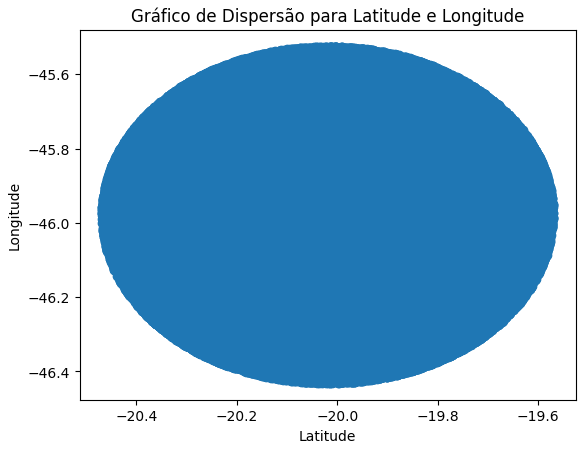

- o gráfico demonstra formato circular de captura de raios, provavelemte obtido por um radar.

### Gráfico de linha Contagem x Tempo
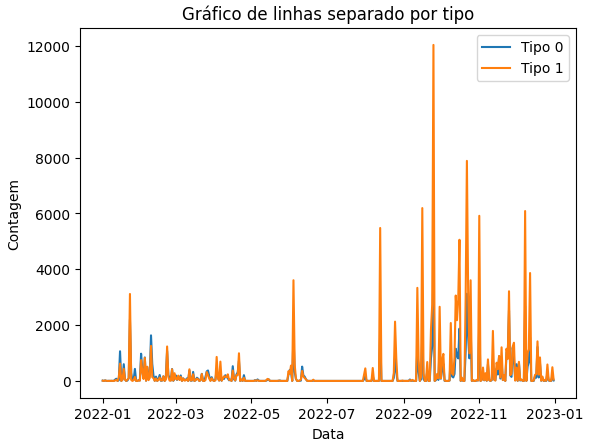

- o gráfico nos da a ideia de que na primavera, que ocorre de setembro ate dezembro no emisfério sul tem maior numero de raios.
- além disso, tambem mostra maior contagem de raios intra nuvens (tipo 1).

### Histograma Hora do dia x Contagem
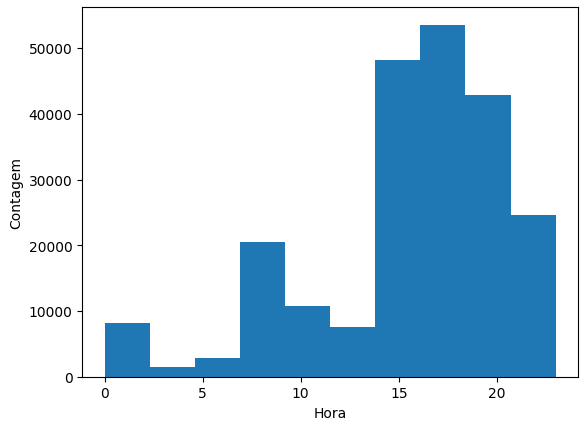

- se torna evidente a grande contagem de raios occorrendo apartir do horario das 15h, vale lembrar que ese grafico mede a contagem de todo ano e mostra apenas uma indicação e nao uma regra, cada dia é um dia diferente do outro.

### Histograma Hora do dia x Contagem - Legenda: Tipo
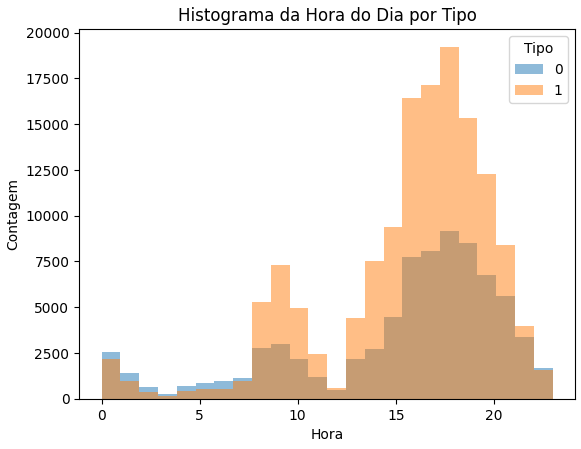

- raios do tipo Nuvem ao Solo so ultrapassam os intrnuvens durante a manha
- novamente a contagem de raios intranuvens se sobressai aos nuvem-solo

### Mapa de densidade de raios
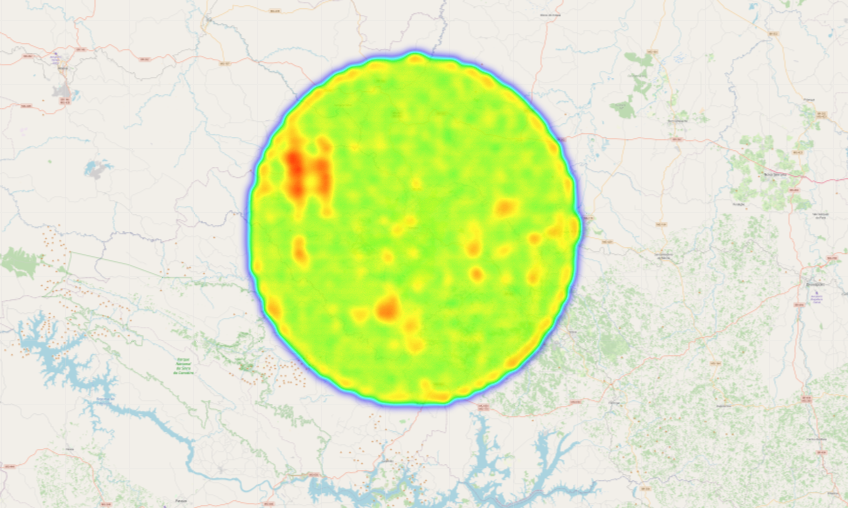

- região ao sul de campos altos, é um epicentro de raios da área de bambuí

-------------

## Analise dia 13/08/2022

#### Objetivo:
Vamos analisar o dia 13/08/2022 ja que neste ocorreram muitas descargas, o intuido de escolher um dia com grande frequencia é aproveitar a grande quantidade de dados para análise
#### **Mapa de densidade de raios dos dois tipos dia 13 de agosto de 2022**
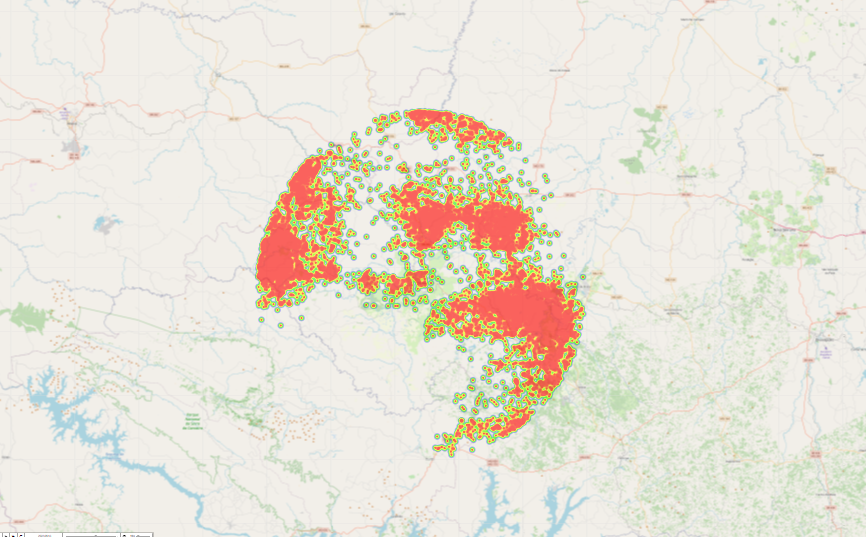


- com o mapa de densidade acima podemos notar a principal incidencia no lado norte da área de detecção este tambem e o ponto com maior incidenia em todo ano.

#### **Histograma de incidencia de raios do dia 13 de agosto de 2022**
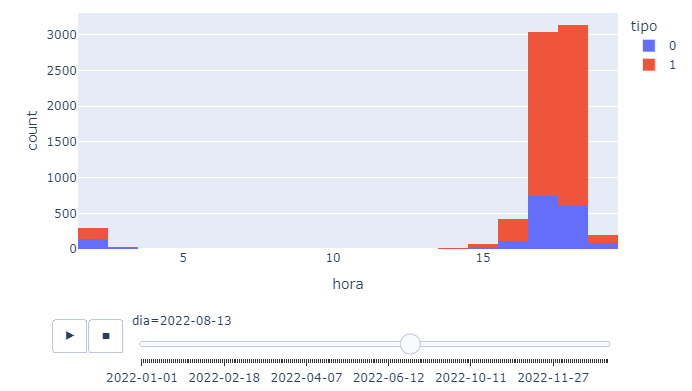

- novamente nota-se a concentração de descargas atmosféricas apartir do horário das 15 horas

----------------

## Diferenças entre os Tipos de Descargas Atmosféricas

Primeiramente é nescessário entender oque é cada tipo

 - Tipo de descarga atmosférica, onde 0 representa nuvem-solo e 1 representa intranuvem.

**Descargas Nuvem-Solo (CG - Cloud-to-Ground)**: Descargas que ocorrem entre uma nuvem e o solo.

**Descargas Intra-Nuvem (IC - Intra-Cloud)**: Descargas que acontecem dentro da nuvem.

### **- Tipo 1 intranuvem** 
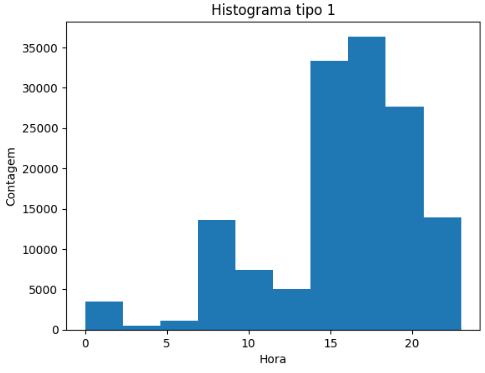

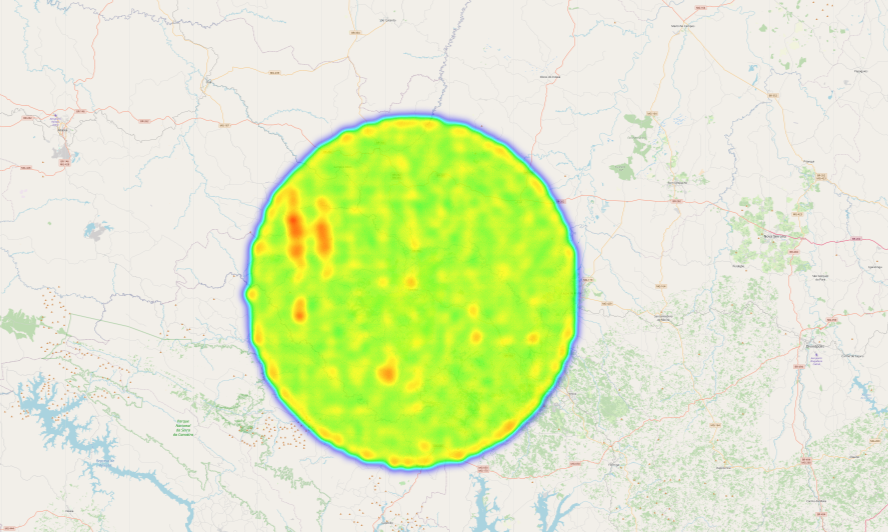

### Tipo 1 dia 13/08/22
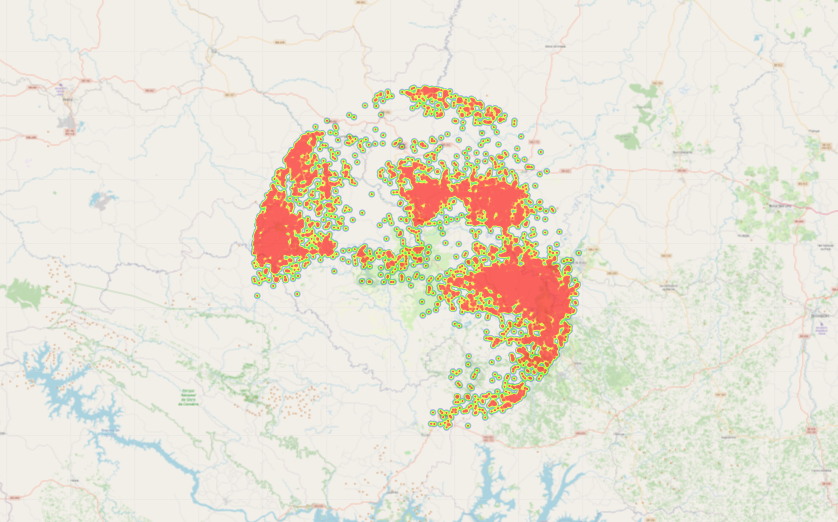

### **- Tipo 0 nuvem-solo** 
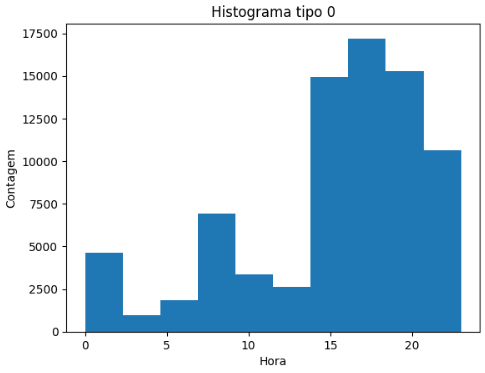

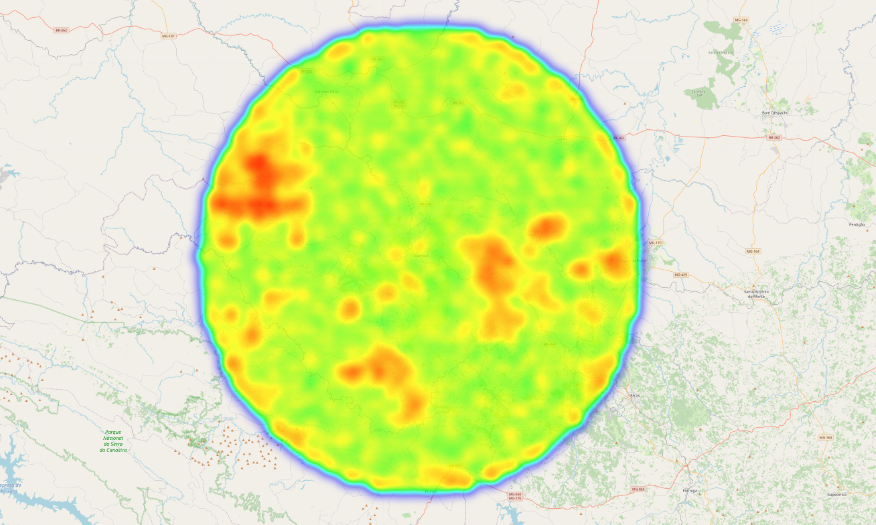

#### Tipo 0 dia 13/08/22
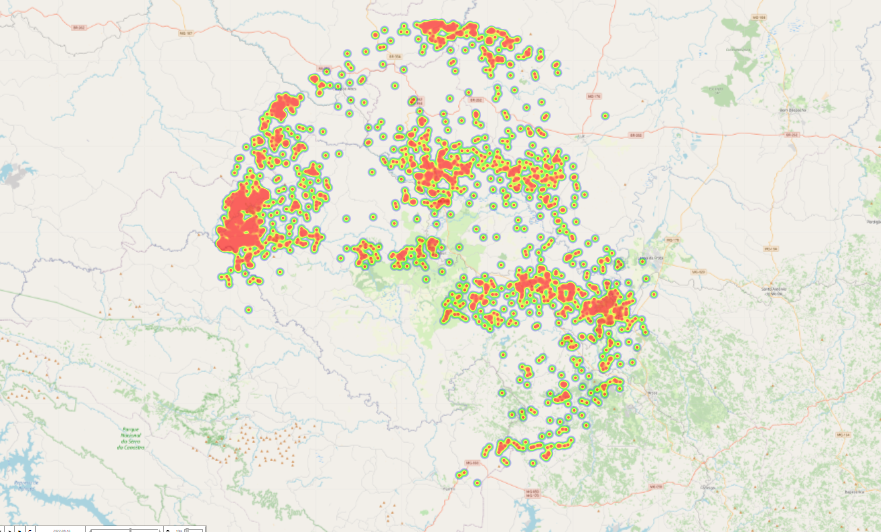

descargas intranuvens: os raios em intranuvens tem maior quantidade porém são mais espaçados

descargas nuvem-solo: os raios nuvem-solo tem menor quantidade porem são mais concentrados em lugares

para notar de uma forma numérica, pode-se vizualizar a diferença dos eixos Y nos dois histogramas que tem escalas diferentes.

--------